In [ ]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
from scipy.stats import t, beta as b, gamma
import pymc3 as pm
import logging
logger = logging.getLogger('pymc3')
logger.setLevel(logging.ERROR)
import arviz as az
import statsmodels.api as sm
import eli5
from eli5.sklearn import PermutationImportance
from sklearn.ensemble import StackingRegressor
from functools import reduce
import shap
shap.initjs()

## Table of Contents:
1. [Feature creation and data quality check](#kpi-definition-and-data-processing) <br><br>
2. [Data exploration](#data-exploration)
    - [KPI visualization](#kpi-visualization)
        - [Overall](#viz-overall)
        - [# of overspend campaign](#viz-overspend)
        - [Overspend ratio](#viz-overspend-ratio)
        - [Campaign budget](#viz-budget)
    - [Explanatory modelling](#explanatory-modelling)
        - [Train model to predict overspend campaign by company size and budget](#overspend-campaign-prediction)
        - [Train model to predict product type by budget](#product-type-prediction) <br><br>

In [7]:
df = pd.read_csv("./data_v3.csv")
print(df.shape)
df.head()

(15474, 4)


,treatment,company_size,campaign_spend,campaign_budget
0,False,small,10.4477,3.9035
1,False,medium,3.7776,1.9872
2,False,medium,46.1880,55.4523
3,False,small,6.6271,6.5136
4,False,small,92.3405,83.1018


# 1. Feature creation and data quality check <a class="anchor" id="kpi-definition-and-data-processing"></a>

In [4]:
# Create indicators of overspend (and underdspend for back-up analysis)
df['overspend'] = df['overspend_ratio'] = df['underspend'] = df['underspend_ratio'] = ""
for i in range(len(df)):
    if df['campaign_budget'][i] < df['campaign_spend'][i]:
        df['overspend'][i] = df['campaign_spend'][i] - df['campaign_budget'][i]
        df['overspend_ratio'][i] = df['overspend'][i] / df['campaign_budget'][i]
        df['underspend'][i] = df['underspend_ratio'][i]= 0   
    elif df['campaign_budget'][i] > df['campaign_spend'][i]:
        df['overspend'][i] = df['overspend_ratio'][i] = 0
        df['underspend'][i] = df['campaign_budget'][i] - df['campaign_spend'][i]
        df['underspend_ratio'][i] = df['underspend'][i] / df['campaign_budget'][i]
    else:
        df['overspend'][i] = df['overspend_ratio'][i] = df['underspend'][i] = df['underspend_ratio'][i] = 0
        
df['overspend'] = pd.to_numeric(df['overspend'])
df['overspend_ratio'] = pd.to_numeric(df['overspend_ratio'])
df['underspend'] = pd.to_numeric(df['underspend'])
df['underspend_ratio'] = pd.to_numeric(df['underspend_ratio'])

# Define overspnd campaign as >1% of their budget
df['over_one_percent'] = list(map(lambda x: 1 if (x>0.01) else 0, df['overspend_ratio']))
df['under_one_percent'] = list(map(lambda x: 1 if (x>0.01) else 0, df['underspend_ratio']))
# Create log version for spend and budget for visualization
df['spend_log'], df['budget_log']  = np.log(df['campaign_spend']), np.log(df['campaign_budget']) 
df.head()

,treatment,company_size,campaign_spend,campaign_budget,overspend,overspend_ratio,underspend,underspend_ratio,over_one_percent,under_one_percent,spend_log,budget_log
0,False,small,10.45,3.90,6.54,1.68,0.00,0.00,1,0,2.35,1.36
1,False,medium,3.78,1.99,1.79,0.90,0.00,0.00,1,0,1.33,0.69
2,False,medium,46.19,55.45,0.00,0.00,9.26,0.17,0,1,3.83,4.02
3,False,small,6.63,6.51,0.11,0.02,0.00,0.00,1,0,1.89,1.87
4,False,small,92.34,83.10,9.24,0.11,0.00,0.00,1,0,4.53,4.42


In [5]:
# Check data quality
table = []
for col in df.columns:
    table.append((col, df[col].dtype, df[col].nunique(), df.shape[0] - (df[col].isnull().sum()), round(100 - (df[col].isnull().sum()*100/df.shape[0]), 2)))
pd.DataFrame(table, columns=['Column name','Type','Unique value', 'Available Value','% Availability']).set_index('Column name').reset_index() 

,Column name,Type,Unique value,Available Value,% Availability
0,treatment,bool,2,15474,100.0
1,company_size,object,3,15474,100.0
2,campaign_spend,float64,15375,15474,100.0
3,campaign_budget,float64,15367,15474,100.0
4,overspend,float64,11816,15474,100.0
5,overspend_ratio,float64,11923,15474,100.0
6,underspend,float64,3495,15474,100.0
7,underspend_ratio,float64,3495,15474,100.0
8,over_one_percent,int64,2,15474,100.0
9,under_one_percent,int64,2,15474,100.0


In [6]:
# Check outlisers
cont = df[df.treatment==False]
treat = df[df.treatment==True]

g1 = alt.Chart(cont, title='Control budget').mark_boxplot().encode(x='company_size:O', y=alt.Y('campaign_budget:Q', title='')).properties(width=80,height=300)
g2 = alt.Chart(treat, title='Treatment budget').mark_boxplot().encode(x='company_size:O', y=alt.Y('campaign_budget:Q', title='')).properties(width=80,height=300)
g3 = alt.Chart(cont, title='Control spend').mark_boxplot().encode(x='company_size:O', y=alt.Y('campaign_spend:Q', title='')).properties(width=80,height=300)
g4 = alt.Chart(treat, title='Treatment spend').mark_boxplot().encode(x='company_size:O', y=alt.Y('campaign_spend:Q', title='')).properties(width=80,height=300)
g5 = alt.Chart(cont, title='Control overspend').mark_boxplot().encode(x='company_size:O', y=alt.Y('overspend:Q', title='')).properties(width=80,height=300)
g6 = alt.Chart(treat, title='Treatment overspend').mark_boxplot().encode(x='company_size:O', y=alt.Y('overspend:Q', title='')).properties(width=80,height=300)
g1 | g2 | g3 | g4 | g5 | g6

alt.HConcatChart(...)

- **Important to note that there are extreme values in budget, spend, and overspend, which leads to the skewness of data**
- To generalize analysis for numerical values, remove the extreme values

In [7]:
# Remove outliers of spend, budget, and overspend to generalize the analysis
df2 = df[(df.campaign_budget < 10000000) & (df.campaign_spend < 3000000) & (df.overspend < 250000)]
print('Before\n', df.treatment.value_counts(), '\n')
print('After\n', df2.treatment.value_counts())

Before
 True     7741
False    7733
Name: treatment, dtype: int64 

After
 True     7739
False    7733
Name: treatment, dtype: int64


In [8]:
# Quick sanitary check of company split between test groups
alt.Chart(
    df2, title='Company size proportion by test group').mark_bar().encode(
    alt.X('treatment:O'), 
    alt.Y('count():Q', title='count of campaigns'),
    color=alt.Color('company_size',scale=alt.Scale(scheme='tealblues')),
    tooltip=[alt.Tooltip('count():Q')]).properties(width=400,height=200)

alt.Chart(...)

- Each company size is almost evenly splited
- Now, data has been cleaned and checked, ready for the analysis

In [9]:
# Create dataframe object for analysis by subgroups
cont = df2[df2.treatment==False]
treat = df2[df2.treatment==True]

cl, cm, cs = cont[cont.company_size=='large'], cont[cont.company_size=='medium'], cont[cont.company_size=='small']
tl, tm, ts = treat[treat.company_size=='large'], treat[treat.company_size=='medium'], treat[treat.company_size=='small']

# 2. Data exploration <a class="anchor" id="data-exploration"></a>
## 2.1. KPI visualization <a class="anchor" id="kpi-visualization"></a>
### 2.1.1. Overall  <a class="anchor" id="viz-overall"></a>

In [14]:
# Means of numerical indicators
num_cols = ['campaign_budget','over_one_percent','overspend_ratio','under_one_percent', 'underspend_ratio']
df2.groupby(['treatment'])[num_cols].mean()

,campaign_budget,over_one_percent,overspend_ratio,under_one_percent,underspend_ratio
treatment,,,,,
False,4641.83,0.74,0.31,0.19,0.06
True,5350.74,0.67,0.26,0.26,0.08


In [15]:
df2.groupby(['treatment','company_size'])[num_cols].mean()

campaign_budget  over_one_percent  overspend_ratio  \
treatment company_size                                                       
False     large                 5933.97              0.69             0.19   
          medium                6342.86              0.61             0.13   
          small                 3538.66              0.79             0.42   
True      large                12655.71              0.62             0.13   
          medium                4612.67              0.60             0.15   
          small                 1585.48              0.71             0.35   

                        under_one_percent  underspend_ratio  
treatment company_size                                       
False     large                      0.23              0.07  
          medium                     0.27              0.08  
          small                      0.15              0.05  
True      large                      0.30              0.10  
          medium                     0.31              0.10  
          small                      0.23              0.07

- **Overspend campaign proportion was lower in treatment group, except for medium companies**
- **Large companies put higher budget on average for cost per impression product (around double)**
- **Small companies lowered their budget on average for cost per impression product**, and they have relatively higher overspend probability and ratio
- Underspend probability and ratio increased in treatment group overall

In [16]:
# Median of numerical indicators as some of the variables are right skewed
num_cols = ['campaign_budget','overspend_ratio']
df2.groupby(['treatment'])[num_cols].median()

,campaign_budget,overspend_ratio
treatment,,
False,65.38,0.06
True,38.58,0.05


In [17]:
df2.groupby(['treatment','company_size'])[num_cols].median()

campaign_budget  overspend_ratio
treatment company_size                                  
False     large                  145.38             0.04
          medium                  95.23             0.02
          small                   28.99             0.13
True      large                  129.57             0.03
          medium                  90.59             0.02
          small                   20.29             0.08

- **Mediam of budget decreased for all company size**

Text(0.5, 1.0, 'Treatment correlation map')

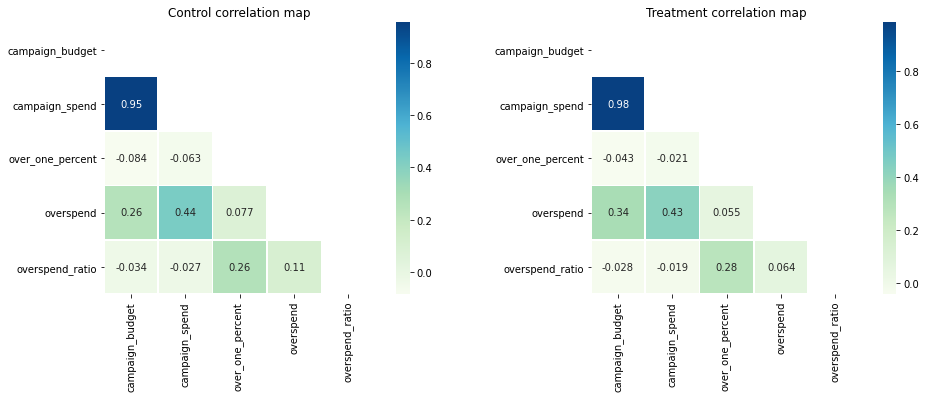

In [18]:
corr0 = cont.loc[:, cont.columns.difference(['treatment','spend_log','budget_log','underspend','under_one_percent','underspend_ratio'])].corr()
mask0 = np.zeros_like(corr0, dtype=np.bool)
mask0[np.triu_indices_from(mask0)] = True

corr1 = treat.loc[:, treat.columns.difference(['treatment','spend_log','budget_log','underspend','under_one_percent','underspend_ratio'])].corr()
mask1 = np.zeros_like(corr1, dtype=np.bool)
mask1[np.triu_indices_from(mask1)] = True

fix, ax = plt.subplots(ncols=2, figsize=(16, 5))
sns.heatmap(corr0, mask=mask0, square=True, linewidths=.5, ax=ax[0], annot=True, cmap="GnBu").set_title("Control correlation map")
sns.heatmap(corr1, mask=mask1, square=True, linewidths=.5, ax=ax[1], annot=True, cmap="GnBu").set_title("Treatment correlation map")

- **Amount of overspend and campaign spend / budget have relatively higher positive correlation**
- Assumption: Amount of overspend = # of events (namely clicks or impressions) * P(Latency) * Cost per events
- If above holds and **if P(Latency) remains relatively constant regardless of the volume of events, then the higher the spend** (and possibly budget in case where there is little discrepancy between budget and spend), **the higher the clicks or impressions, thus the higher the amount of overspend**

### 2.1.1. # of overspend campaign <a class="anchor" id="viz-overspend"></a>

Before processing
    treatment  # of overspend campaigns
0      False                      5716
1       True                      5180 

After processing
    treatment  # of overspend campaigns
0      False                      5716
1       True                      5179 



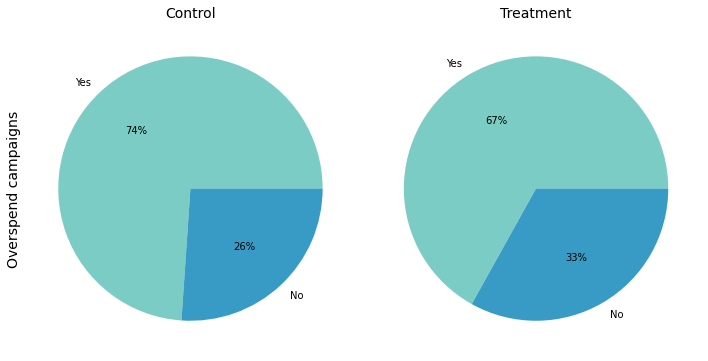

In [10]:
# Check the overspend campaign proportion performance
print('Before processing\n',
    df.groupby(df.treatment).sum()[['over_one_percent']].reset_index().rename(columns={'over_one_percent':'# of overspend campaigns'}),'\n')

print('After processing\n',
    df2.groupby(df2.treatment).sum()[['over_one_percent']].reset_index().rename(columns={'over_one_percent':'# of overspend campaigns'}),'\n')

cmap = plt.cm.GnBu
colors = cmap(np.linspace(0.5,0.9, len([1,5,8])))
fig, ax = plt.subplots(ncols=2, figsize=(10,5))
ax[0].pie(cont.over_one_percent.value_counts(), labels=['Yes','No'], autopct='%1.0f%%', colors=colors)
ax[0].set_title('Control', fontsize=14)
ax[0].set_ylabel('Overspend campaigns', fontsize=14)
ax[1].pie(treat.over_one_percent.value_counts(), labels=['Yes','No'], autopct='%1.0f%%', colors=colors)
ax[1].set_title('Treatment', fontsize=14)
plt.tight_layout()

- **Treatment group has smaller proportion of overspend campaigns**

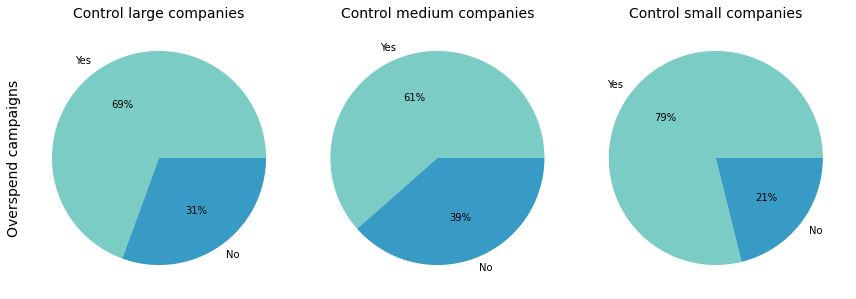

In [11]:
# Check by company size
fig, ax = plt.subplots(ncols=3, figsize=(12,5))
ax[0].pie(cl.over_one_percent.value_counts(), labels=['Yes','No'], autopct='%1.0f%%', colors=colors)
ax[0].set_title('Control large companies', fontsize=14)
ax[0].set_ylabel('Overspend campaigns', fontsize=14)
ax[1].pie(cm.over_one_percent.value_counts(), labels=['Yes','No'], autopct='%1.0f%%', colors=colors)
ax[1].set_title('Control medium companies', fontsize=14)
ax[2].pie(cs.over_one_percent.value_counts(), labels=['Yes','No'], autopct='%1.0f%%', colors=colors)
ax[2].set_title('Control small companies', fontsize=14)
plt.tight_layout()

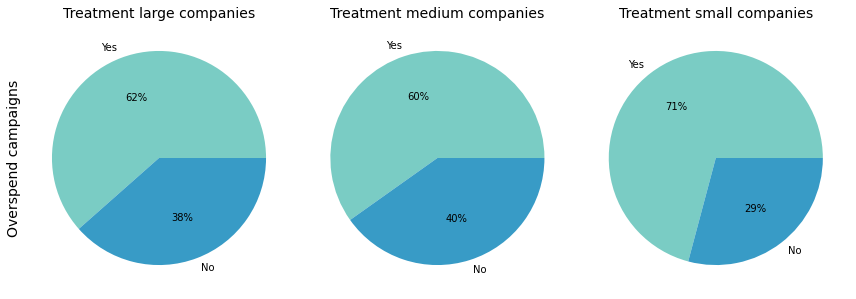

In [12]:
fig, ax = plt.subplots(ncols=3, figsize=(12,5))
ax[0].pie(tl.over_one_percent.value_counts(), labels=['Yes','No'], autopct='%1.0f%%', colors=colors)
ax[0].set_title('Treatment large companies', fontsize=14)
ax[0].set_ylabel('Overspend campaigns', fontsize=14)
ax[1].pie(tm.over_one_percent.value_counts(), labels=['Yes','No'], autopct='%1.0f%%', colors=colors)
ax[1].set_title('Treatment medium companies', fontsize=14)
ax[2].pie(ts.over_one_percent.value_counts(), labels=['Yes','No'], autopct='%1.0f%%', colors=colors)
ax[2].set_title('Treatment small companies', fontsize=14)
plt.tight_layout()

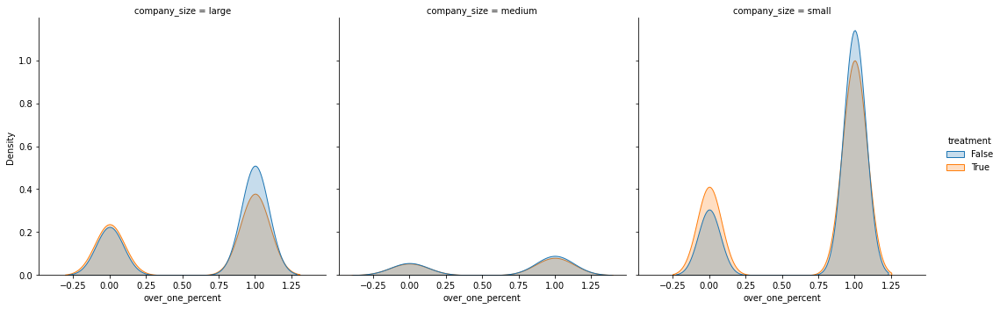

In [74]:
sns.displot(df2.sort_values(by=["company_size"]), x="over_one_percent", hue="treatment",  col="company_size", kind="kde", fill=True)
plt.show()

- **Except medium size companies, the # of overspend decreased in treatment group**

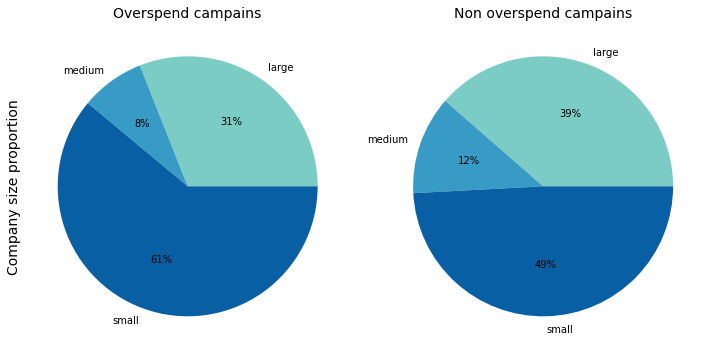

In [75]:
over = df2[df2.over_one_percent==True]
non_over = df2[df2.over_one_percent==False]
fig, ax = plt.subplots(ncols=2, figsize=(10,5))
ax[0].pie(over.company_size.value_counts().sort_index(), labels=['large','medium','small'], autopct='%1.0f%%', colors=colors)
ax[0].set_title('Overspend campains', fontsize=14)
ax[0].set_ylabel('Company size proportion', fontsize=14)
ax[1].pie(non_over.company_size.value_counts().sort_index(), labels=['large','medium','small'], autopct='%1.0f%%', colors=colors)
ax[1].set_title('Non overspend campains', fontsize=14)
plt.tight_layout()

- In general, **small companies have higher likelihood of overspend**, while large companie are the opposite

In [19]:
g1 = alt.Chart(
    cont,title='Control group').mark_circle(opacity=0.8,strokeWidth=1).encode(
    x=alt.X('budget_log'),
    y=alt.Y('spend_log'),
    #size='budget_log',
    color='company_size').properties(width=350,height=300)

line1 = pd.DataFrame({
    'spend_log': [min(cont.spend_log), max(cont.spend_log)],
    'budget_log': [min(cont.budget_log), max(cont.budget_log)]})
line1 = alt.Chart(line1).mark_line(color='grey').encode(
    x='budget_log',
    y='spend_log')

g2 = alt.Chart(
    treat,title='Treatment group').mark_circle(opacity=0.8,
    strokeWidth=1).encode(
    x=alt.X('budget_log'),
    y=alt.Y('spend_log'),
    #size='budget_log',
    color='company_size').properties(width=350,height=300)

line2 = pd.DataFrame({
    'spend_log': [min(treat.spend_log), max(treat.spend_log)],
    'budget_log': [min(treat.budget_log), max(treat.budget_log)]})
line2 = alt.Chart(line2).mark_line(color='grey').encode(
    x='budget_log',
    y='spend_log')

g1+line1 | g2+line2

alt.HConcatChart(...)

- No overspend then budget and spend fits on or below the diagnal
- We can observe that there are less overspend campaign for treatment group

### 2.1.3. Overspend ratio <a class="anchor" id="viz-overspend-ratio"></a>

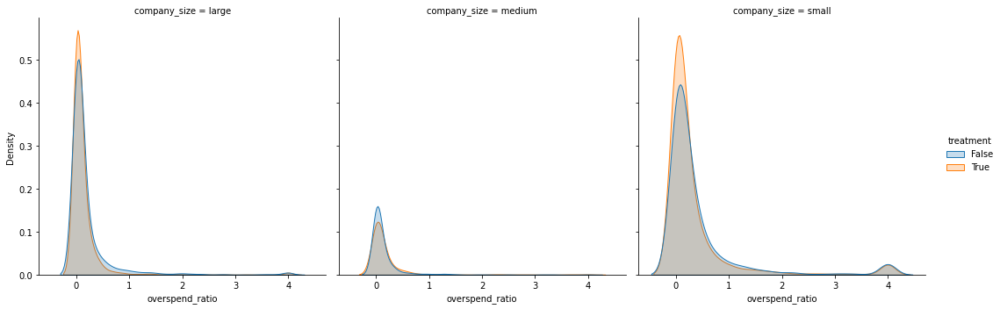

In [73]:
sns.displot(df2.sort_values(by=["company_size"]), x="overspend_ratio", hue="treatment",  col="company_size", col_order=['large','medium','small'], kind="kde", fill=True)
plt.show()

- **Except medium size companies, the overspend ratio decreased in treatment group**
- Overspend ratio have extreme density area in around 400%

In [21]:
g = alt.Chart(df2, title='Overspend ratio').mark_boxplot().encode(x='overspend_ratio:Q', y='company_size:O').properties(width=400,height=180)
g

alt.Chart(...)

In [22]:
# boxplot
g1 = alt.Chart(cont, title='Control overspend ratio').mark_boxplot().encode(x='overspend_ratio:Q', y='company_size:O').properties(width=400,height=180)
g2 = alt.Chart(treat, title='Treatment overspend ratio').mark_boxplot().encode(x='overspend_ratio:Q', y='company_size:O').properties(width=400,height=180)
g1 | g2

alt.HConcatChart(...)

- Average overspend ratio of small companies are higher in both control and treatment group
- Range of overspend ratio is about equal in all companies in both control and treatment group

### 2.1.4. Campaign budget <a class="anchor" id="viz-budget"></a>

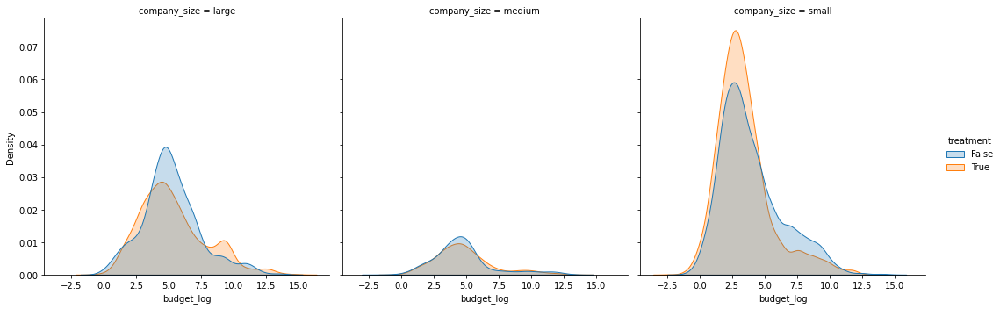

In [23]:
sns.displot(df2.sort_values(by=["company_size"]), x="budget_log", hue="treatment",  col="company_size", kind="kde", fill=True)

In [24]:
g1 = alt.Chart(
    cont, title='Control log budget').mark_boxplot().encode(
    x='budget_log:Q', y='company_size:O').properties(width=400,height=100)
bar1 = g1.mark_rule().encode(x='min(budget_log)', x2='max(budget_log)')

g2 = alt.Chart(
    treat, title='Treatment log budget').mark_boxplot().encode(
    x='budget_log:Q', y='company_size:O').properties(width=400,height=100)
bar2 = g2.mark_rule().encode(x='min(budget_log)', x2='max(budget_log)')
g1+bar1 | g2+bar2

alt.HConcatChart(...)

In [25]:
g1 = alt.Chart(
    df2, title='Control log budget').mark_boxplot().encode(
    x='budget_log:Q', y='company_size:O').properties(width=400,height=100)
bar1 = g1.mark_rule().encode(x='min(budget_log)', x2='max(budget_log)')

g1+bar1

alt.LayerChart(...)

## 2.2. Explanatory modeling <a class="anchor" id="explanatory-modelling"></a>
- Treatment effect can vary across subgroups (here, company size)
- We have observed some different tendencies by test group and company size, but try to see how the model interprets the coefficient when predicting overspend campaings

### 2.2.1. Train model to predict overspend campaings by company size and budget <a class="anchor" id="overspend-campaign-prediction"></a>

In [27]:
df_dummy = pd.get_dummies(df2[['company_size', 'over_one_percent', 'budget_log']])
df_dummy.drop(['company_size_medium'], axis=1, inplace=True)
train, test = train_test_split(df_dummy, test_size=0.2, random_state=0)
X_train = train.drop(['over_one_percent'], axis=1).astype(float)
y_train = train['over_one_percent'].astype(float)
X_test = test.drop(['over_one_percent'], axis=1).astype(float)
y_test = test['over_one_percent'].astype(float)

logit = sm.Logit(y_train, X_train).fit()

yhat = logit.predict(X_test)
pred = list(map(round, yhat))
print('Accuracy: ', accuracy_score(y_test, pred))

Optimization terminated successfully.
         Current function value: 0.587590
         Iterations 5
Accuracy:  0.6962843295638126


In [28]:
logit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:       over_one_percent   No. Observations:                12377
Model:                          Logit   Df Residuals:                    12374
Method:                           MLE   Df Model:                            2
Date:                Fri, 26 Nov 2021   Pseudo R-squ.:                 0.03570
Time:                        19:18:22   Log-Likelihood:                -7272.6
converged:                       True   LL-Null:                       -7541.8
Covariance Type:            nonrobust   LLR p-value:                1.164e-117
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
budget_log            -0.1499      0.007    -20.690      0.000      -0.164      -0.136
company_size_large     1.4428      0.052     27.863      0.000       1.341       1.544
company_size_small     1.6421      0.040     41.105      0.000       1.564       1.720
======================================================================================
"""

- **Company size and budget had statistical significant coefficients for predicting overspend campaings**
- Budget have negative coefficient
- As we have observed, small companies have strong positive correlation to overspend

Accuracy:  0.7408723747980613


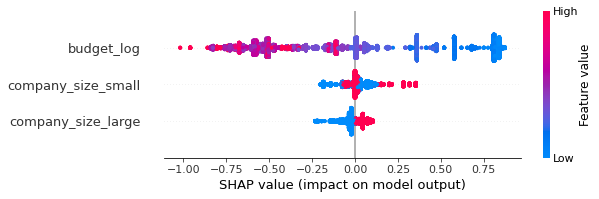

In [30]:
xgb = xgboost.XGBClassifier(objective='binary:logistic', n_estimators=12, eta=0.1, grow_policy='lossguide',
                           reg_lambda=5, reg_alpha=5, eval_metric=["logloss"]).fit(X_train, y_train)

pred_xgb = xgb.predict(X_test)
print('Accuracy: ', accuracy_score(y_test, pred_xgb))
explainer = shap.TreeExplainer(xgb)
shap_values_xgb = explainer.shap_values(X_train)
shap.force_plot(explainer.expected_value, shap_values_xgb[0,:], X_train.iloc[0,:])
shap.summary_plot(shap_values_xgb, X_train)

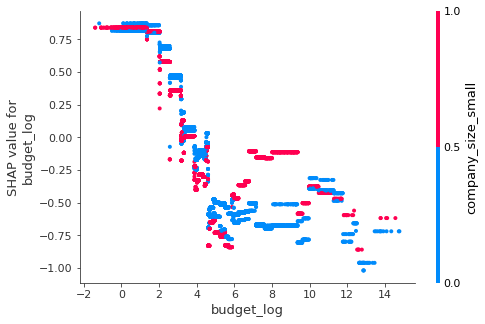

In [31]:
shap.dependence_plot('budget_log', shap_values_xgb, X_train)

- The lower the budget, the higher the likelihood of overspend

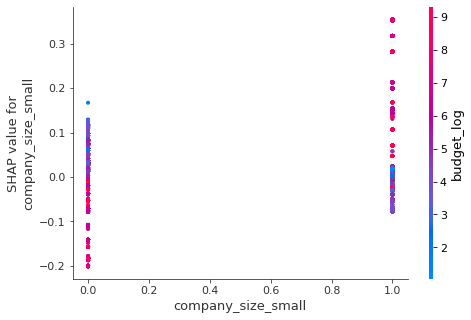

In [32]:
shap.dependence_plot('company_size_small', shap_values_xgb, X_train)

- If small company, then increases the likelihood of overspend

### 2.2.2. Train model to predict product type by budget <a class="anchor" id="product-type-prediction"></a>

Accuracy:  0.5633074935400517


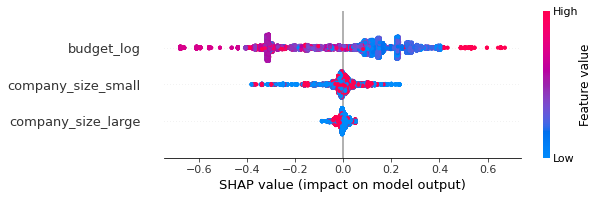

In [33]:
large, small = df2[df2.company_size=='large'], df2[df2.company_size=='small']

df_dummy = pd.get_dummies(df2[['company_size', 'budget_log', 'treatment']])
df_dummy.drop(['company_size_medium'], axis=1, inplace=True)
train, test = train_test_split(df_dummy, test_size=0.1, random_state=42)
X_train = train.drop(['treatment'], axis=1).astype(float)
y_train = train['treatment'].astype(float)
X_test = test.drop(['treatment'], axis=1).astype(float)
y_test = test['treatment'].astype(float)

xgb2 = xgboost.XGBClassifier(objective='binary:logistic', n_estimators=20, eta=0.1, grow_policy='lossguide',
                           reg_lambda=5, reg_alpha=5, eval_metric=["logloss"]).fit(X_train, y_train)

pred_xgb = xgb2.predict(X_test)
print('Accuracy: ', accuracy_score(y_test, pred_xgb))
explainer = shap.TreeExplainer(xgb2)
shap_values_xgb = explainer.shap_values(X_train)
shap.force_plot(explainer.expected_value, shap_values_xgb[0,:], X_train.iloc[0,:])
shap.summary_plot(shap_values_xgb, X_train)

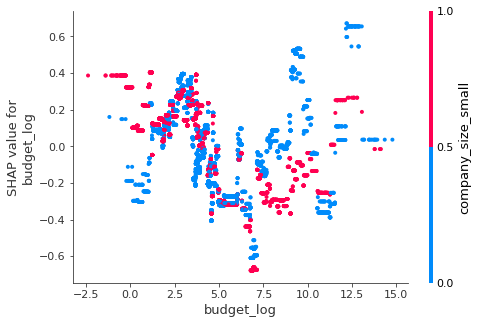

In [34]:
shap.dependence_plot('budget_log', shap_values_xgb, X_train)

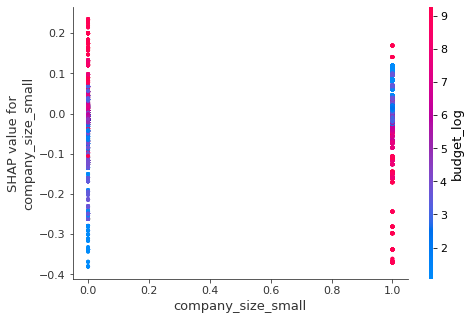

In [35]:
shap.dependence_plot('company_size_small', shap_values_xgb, X_train)

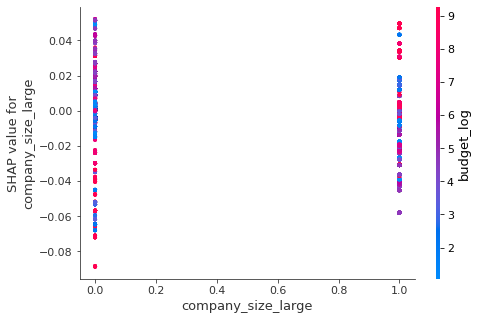

In [36]:
shap.dependence_plot('company_size_large', shap_values_xgb, X_train)

- Model have almost no predicting power, meaning that the new product did not have one-directional impact on budget even within the same company size